
What does the input to a population of neurons in the primary visual cortex look like? In this post, we will try to have a feeling of the structure and statistics of the natural input to such a "ring" model.

This notebook explores this question using a retina-like temporal filtering and oriented Gabor-like filters. It produces this polar plot of the instantaneous energy in the different orientations for a natural movie :

<BR>
<center><video controls autoplay loop src="../files/2018-11-05_Ring_input.mp4" width=61.8%/> </center>
<BR>

One observes different striking features in the structure of this input to populations of V1 neurons:

- input is sparse: often, a few orientations dominate - the shape of these components (bandwidth) seem to be similar,
- there are many "switches": at some moments, the representations flips to another. This is due to cuts in the movie (changes from one scene to the other for instance). In a more realistic setting where we would add eye movements, these switches should also happen during saccades (but is there any knowledge of the occurence of the switch by the visual system?),
- between switches, there is some coherence in amplitude (a component will slowly change its energy) but also in time (a component is more likely to have a ghradually changing oriantation, for instance when the scene rotates).

This structure is specific to the structure of natural images and to the way they transform (translations, rotations, zooms due to the motion and deformation of visual objects). This is certainly incorporated as a "prior" information in the structure of the visual cortex. As to know how and where this is implemented is an open scientific question.

This is joint work with [Hugo Ladret](http://invibe.net/LaurentPerrinet/HugoLadret).
<!-- TEASER_END -->

Let's first initialize the notebook:


In [1]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
FIG_WIDTH = 8
FIGSIZE=(FIG_WIDTH, .618 * FIG_WIDTH)

# loading images

First, I used a sequence of the "Life of Brian" movie which were converted to a numpy array using the [``imageio``](https://imageio.github.io/) library.

In [2]:
video = np.load('/tmp/montypython.npy')
video = np.rot90(video)
#video = np.load('LifeOfBrian.npy')
#video = np.swapaxes(video, 0, -1)
#video = np.swapaxes(video, 0, 1)

N_frame = 8
N_frame = 1024
#video = video[:, 10:(10+36), :] # squaring
video = video[:, :, :N_frame]
N_X, N_Y, N_frame = video.shape
print('video.shape=', video.shape)

video.shape= (54, 54, 1024)


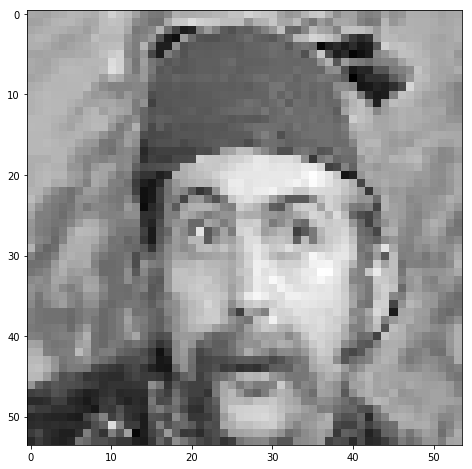

In [3]:
one_image = N_frame//2
image = video[:, :, one_image]
fig, ax = plt.subplots(figsize=(FIG_WIDTH, FIG_WIDTH))
ax.imshow(image, cmap=plt.gray())

# AR(1) filtering

Let's define different strategies for the temporal filtering, first with a moving average, aka AR(1):

In [4]:
alpha = -.61803

In [5]:
%%time
video_ar = np.zeros_like(video)
for i in range(N_frame):
    video_ar[:, :, i] = video[:, :, i] + alpha *video[:, :, i-1]
    

CPU times: user 109 ms, sys: 5.29 ms, total: 114 ms
Wall time: 113 ms


In [6]:
%%time
video_ar = video + alpha * np.roll(video, 1, axis=-1)

CPU times: user 12.5 ms, sys: 5.34 ms, total: 17.8 ms
Wall time: 16.6 ms


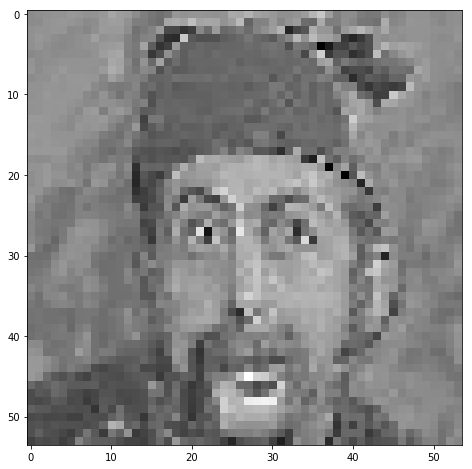

In [7]:
image = video_ar[:, :, one_image]
fig, ax = plt.subplots(figsize=(FIG_WIDTH, FIG_WIDTH))
ax.imshow(image, cmap=plt.gray())

# AR(2) filtering

What if we use a second-order linear filtering?

In [8]:
alpha, beta = -.61803, .61803-1. +.5

In [9]:
%%time
video_ar = video + alpha * np.roll(video, 1, axis=-1) + beta * np.roll(video, 2, axis=-1)

CPU times: user 20.6 ms, sys: 5.37 ms, total: 26 ms
Wall time: 24.8 ms


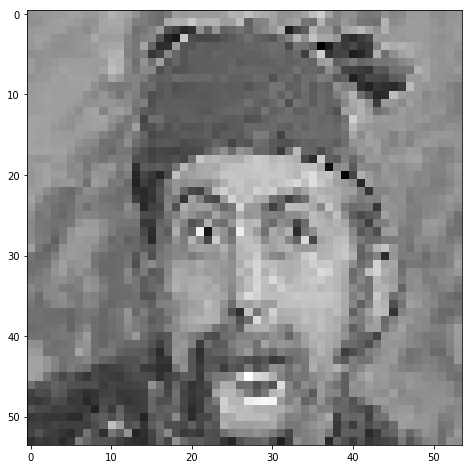

In [10]:
image = video_ar[:, :, one_image]
fig, ax = plt.subplots(figsize=(FIG_WIDTH, FIG_WIDTH))
ax.imshow(image, cmap=plt.gray())

# ARMA(2, 1) filtering

An even more realistic combination, yet still linear:

In [11]:
alpha, beta, gamma = -.61803, .61803-1., .5

In [12]:
%%time
video_ar = video + alpha * np.roll(video, 1, axis=-1) + beta * np.roll(video, 2, axis=-1)
for t in range(5):
    video_ar += gamma**t * np.roll(video_ar, t+1, axis=-1)

CPU times: user 60.5 ms, sys: 912 µs, total: 61.4 ms
Wall time: 60.1 ms


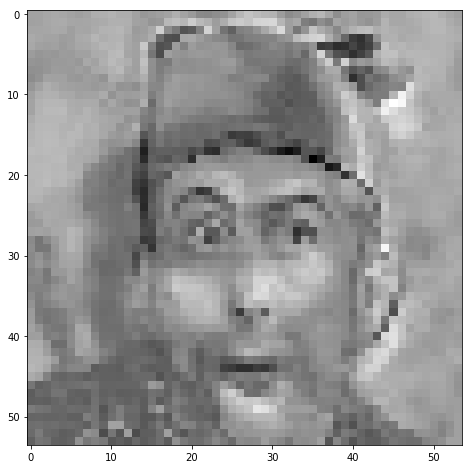

In [13]:
image = video_ar[:, :, one_image]
fig, ax = plt.subplots(figsize=(FIG_WIDTH, FIG_WIDTH))
ax.imshow(image, cmap=plt.gray())

In [14]:
image = video_ar[:, :, one_image]
video = video_ar 

## designing filters for the modeling of the feed-forward processing of V1 filters

Such a population of neurons may be rendered in an abstract way as a ring where the different orientations from $0$ to $\pi$ are arranged on the circle.





lg.pe.B_sf 0.4


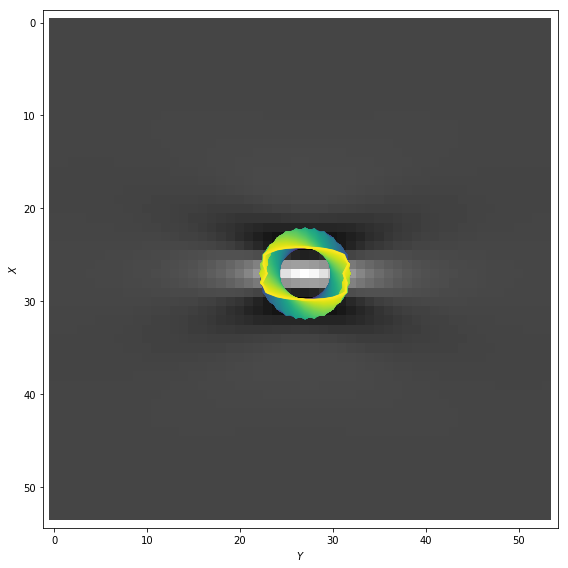

In [15]:
#from SLIP import Image, imread
from LogGabor import LogGabor
parameterfile = 'https://raw.githubusercontent.com/bicv/LogGabor/master/default_param.py'
lg = LogGabor(parameterfile)
lg.set_size((N_X, N_Y))

B_theta = 15 /180 * np.pi
params= {'sf_0':.12, 'B_sf': .5, 'B_theta': B_theta}
print('lg.pe.B_sf', lg.pe.B_sf)

N_theta, N_phase = 180, 2
thetas = np.linspace(0, np.pi, N_theta, endpoint=False)

phi = np.zeros((N_theta, N_phase, N_X, N_Y))

for i_theta, theta in enumerate(thetas):
    x = N_X/2
    y = N_Y/2
    params.update(theta=theta)
    for i_phase in range(N_phase):
        phase = i_phase * np.pi/2
        kernel = lg.invert(lg.loggabor(x, y, **params)*np.exp(-1j*phase))
        phi[i_theta, i_phase, :] = lg.normalize(kernel)

fig, ax = plt.subplots(figsize=(FIG_WIDTH, FIG_WIDTH))

ax.imshow(phi[i_theta, 0, :], cmap=plt.gray())

for i_theta in range(N_theta):
    env = np.sqrt(phi[i_theta, 0, :]**2 + phi[i_theta, 1, :]**2)
    ax.contour(env, levels=[env.max()/2], lw=1, colors=[plt.cm.viridis(i_theta/(N_theta))])
#fig.suptitle('Tiling of visual space using phi')
ax.set_xlabel(r'$Y$')
ax.set_ylabel(r'$X$')
ax.axis('equal')
plt.tight_layout()
#plt.savefig('logPolar_shape.pdf')

In [16]:
print('precision in orientation (as defined by the bandwidth)=', '%.3f' % (lg.pe.B_theta*180/np.pi), 'deg')

precision in orientation (as defined by the bandwidth)= 10.000 deg


# filtering images

Let's now apply these spatial filters to any temporally filtered input image:

In [17]:
image_ = (image*lg.mask).reshape((N_X*N_Y))
print('image_.shape', image_.shape)

image_.shape (2916,)


In [18]:
phi_ = phi.reshape((N_theta, N_phase, N_X*N_Y))
print('phi_.shape', phi_.shape)

phi_.shape (180, 2, 2916)


In [19]:
code = phi_ @ image_
print('All scalar products in one shot = ', (code).shape )

All scalar products in one shot =  (180, 2)


In [20]:
theta_bins = np.linspace(-np.pi/N_theta/2, -3*np.pi/N_theta/2+np.pi, N_theta)
print('theta_bins', theta_bins)
#binedges_theta = np.hstack((theta_bin, theta_bin[0]+np.pi))
#print('binedges_theta', binedges_theta)
width = np.pi/N_theta #binedges_theta[1:] - binedges_theta[:-1]
print('width', width)

theta_bins [-0.00872665  0.00872665  0.02617994  0.04363323  0.06108652  0.07853982
  0.09599311  0.1134464   0.13089969  0.14835299  0.16580628  0.18325957
  0.20071286  0.21816616  0.23561945  0.25307274  0.27052603  0.28797933
  0.30543262  0.32288591  0.3403392   0.3577925   0.37524579  0.39269908
  0.41015237  0.42760567  0.44505896  0.46251225  0.47996554  0.49741884
  0.51487213  0.53232542  0.54977871  0.56723201  0.5846853   0.60213859
  0.61959188  0.63704518  0.65449847  0.67195176  0.68940505  0.70685835
  0.72431164  0.74176493  0.75921822  0.77667152  0.79412481  0.8115781
  0.82903139  0.84648469  0.86393798  0.88139127  0.89884456  0.91629786
  0.93375115  0.95120444  0.96865773  0.98611103  1.00356432  1.02101761
  1.0384709   1.0559242   1.07337749  1.09083078  1.10828408  1.12573737
  1.14319066  1.16064395  1.17809725  1.19555054  1.21300383  1.23045712
  1.24791042  1.26536371  1.282817    1.30027029  1.31772359  1.33517688
  1.35263017  1.37008346  1.38753676  1.4

[]

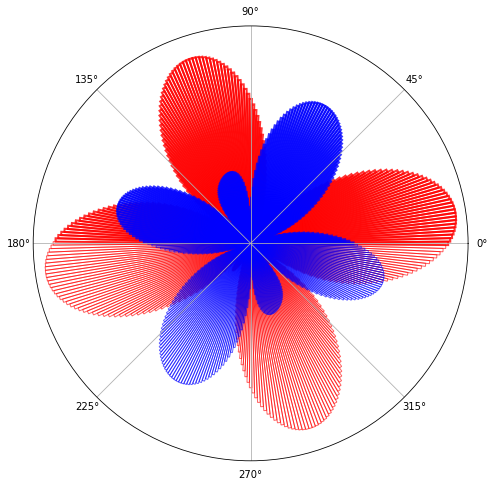

In [21]:
fig, ax = plt.subplots(1, 1, figsize=(FIG_WIDTH, FIG_WIDTH), subplot_kw=dict(projection='polar'))
for i, c in enumerate(['r', 'b']): 
    #ax.plot(theta, np.abs(code[:, i])**.5, color=c)
    #ax.plot(theta+np.pi, np.abs(code[:, i])**.5, color=c)
    # in polar coordinates, probability should be made proportional to
    # the surface, i.e. bars height to the square root of probability
    # see https://laurentperrinet.github.io/sciblog/posts/2014-12-09-polar-bar-plots.html
    ax.bar(theta_bins, (np.abs(code[:, i]))**.5, width=width, color='none', edgecolor=c, lw=2, align='edge', alpha=.8)# edgecolor="none")
    ax.bar(theta_bins+np.pi, (np.abs(code[:, i]))**.5, width=width, color='none', edgecolor=c, align='edge', alpha=.6)
    #ax.plot(theta_bin, np.ones_like(theta_bin)*np.sqrt(v_hist.mean()), 'r--')
    #ax.plot(theta_bin+np.pi, np.ones_like(theta_bin)*np.sqrt(v_hist.mean()), 'r--')
plt.setp(ax, yticks=[])

This shows the polar histogram of the energy of activation for symetric (red) and anti-symmetric (blue) filters.

This process is fast:

In [22]:
%%timeit
code = phi_ @ image_

523 µs ± 7.59 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)


# filtering video

We can now apply it to the whole video.

In [23]:
video_ = video.reshape((N_X*N_Y, N_frame))
print('video_.shape', video_.shape)

video_.shape (2916, 1024)


In [24]:
phi_ = phi.reshape((N_theta, N_phase, N_X*N_Y))
print('phi_.shape', phi_.shape)

phi_.shape (180, 2, 2916)


In [25]:
code = phi_ @ video_
print('All scalar products in one shot = ', (code).shape )

All scalar products in one shot =  (180, 2, 1024)


Text(0.5, 1.0, 'anti-symmetric')

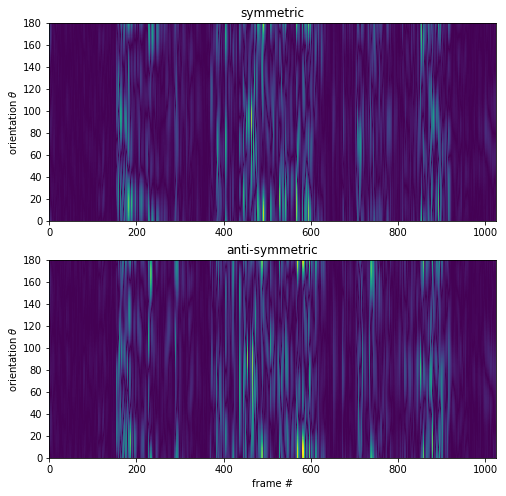

In [26]:
fig, axs = plt.subplots(2, 1, figsize=(FIG_WIDTH, FIG_WIDTH))

for i in range(2): 
    axs[i].pcolormesh(np.abs(code[:, i, :]), cmap=plt.viridis())
    if i: axs[i].set_xlabel('frame #')
    axs[i].set_ylabel(r'orientation $\theta$')
axs[0].set_title('symmetric')
axs[1].set_title('anti-symmetric')

In [27]:
%%timeit
code = phi_ @ video_

641 ms ± 34.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


# temporal evolution for the energy

Following the formula $\cos(\theta)^2 + \sin(\theta)^2 = 1$, one can compute the total energy as the sum of the square of each component. This mimics complex cells.

In [28]:
code2 = np.sqrt(np.sum(code**2, axis=1))
print('code2.shape', code2.shape)

code2.shape (180, 1024)


Text(0, 0.5, 'orientation $\\theta$')

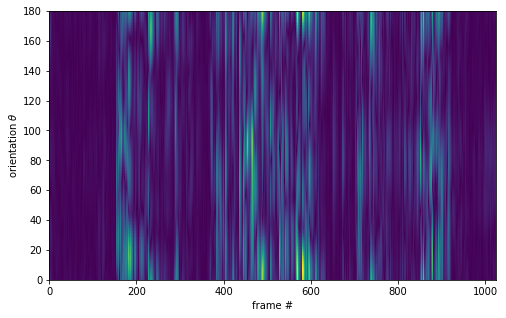

In [29]:
fig, ax = plt.subplots(1, 1, figsize=FIGSIZE)

ax.pcolormesh(code2, cmap=plt.viridis())
ax.set_xlabel('frame #')
ax.set_ylabel(r'orientation $\theta$')


# temporal evolution

Let's now show this temporal evolution as a dynamical polar plot.

In [30]:
theta_mean = np.sum(code2, axis=1)
print('theta_mean.shape', theta_mean.shape)

theta_mean.shape (180,)


(0.0, 6.283185307179586, 0.0, 44.6569249089471)

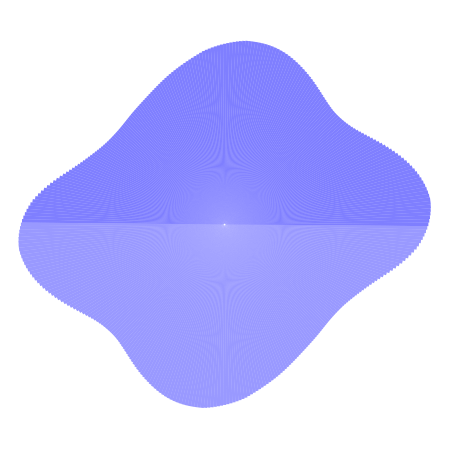

In [31]:
fig, ax = plt.subplots(1, 1, figsize=(FIG_WIDTH, FIG_WIDTH), subplot_kw=dict(projection='polar'))
ax.bar(theta_bins, (theta_mean)**.5, width=width, color=c, align='edge', alpha=.5)
ax.bar(theta_bins+np.pi, (theta_mean)**.5, width=width, color=c, align='edge', alpha=.4)
ax.set_xticks([])
ax.set_yticks([])
#ax.grid(False)
ax.axis('off')

In [32]:
code2_mean = np.mean(code2, axis=0)
print('code2_mean.shape', code2_mean.shape)

code2_mean.shape (1024,)


Text(0, 0.5, 'energy in orientation $\\theta$')

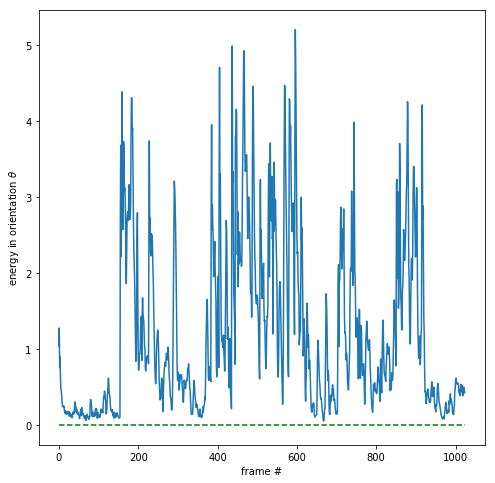

In [33]:
fig, ax = plt.subplots(1, 1, figsize=(FIG_WIDTH, FIG_WIDTH))
ax.plot(code2_mean)
ax.plot(np.zeros_like(code2_mean), 'g--')
ax.set_xlabel('frame #')
ax.set_ylabel(r'energy in orientation $\theta$')

Text(0, 0.5, 'orientation $\\theta$')

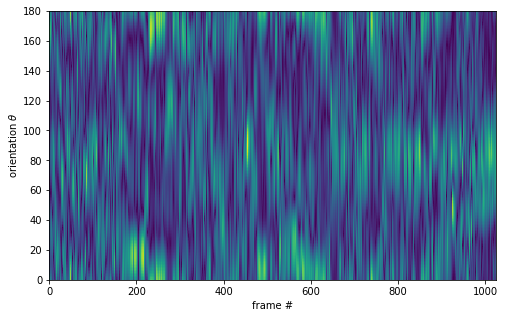

In [34]:
fig, ax = plt.subplots(1, 1, figsize=FIGSIZE)

ax.pcolormesh(code2/code2_mean[None, :], cmap=plt.viridis())
ax.set_xlabel('frame #')
ax.set_ylabel(r'orientation $\theta$')


Text(0, 0.5, 'orientation $\\theta$')

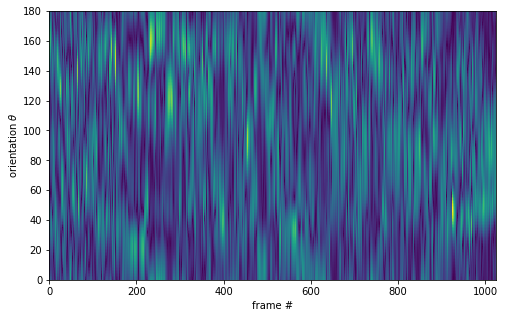

In [35]:
fig, ax = plt.subplots(1, 1, figsize=FIGSIZE)

ax.pcolormesh(code2/code2_mean[None, :]/theta_mean[:, None], cmap=plt.viridis())
ax.set_xlabel('frame #')
ax.set_ylabel(r'orientation $\theta$')


# temporal evolution: animation

In [36]:
%%capture
import matplotlib.animation
plt.rcParams["animation.html"] = "jshtml"
#plt.rc('animation', html='html5')
import numpy as np

code2_norm = (np.abs(code2/code2_mean[None, :]/theta_mean[:, None]))**.5
fig, ax = plt.subplots(1, 1, figsize=(FIG_WIDTH, FIG_WIDTH), 
                       constrained_layout=True, subplot_kw=dict(projection='polar'))

N_start, N_frame_, periods = 150, N_frame//5, 4
N_start, N_frame_, periods = 180, 240, 4
#N_start, N_frame_, periods = 150, 8, 4
vmax = 1.01*np.max(code2_norm)
cmap = plt.get_cmap('twilight_shifted')

opts = dict(edgecolor="none")#width=width, align='edge')# 
topts = dict(style='italic', size=25, family='Arial', transform=ax.transAxes, 
        bbox={'facecolor':'white', 'edgecolor':'white', 'alpha':0.8, 'pad':2})
fps = 24 # just guessing
T = N_frame_/fps
theta_text, radius_text = -55./180.*np.pi, 1.05*vmax
x_text, y_text = .005, .925
x_shift, y_shift = .8, .005

theta_bins_ = np.hstack((theta_bins, theta_bins+np.pi, theta_bins[0]+2*np.pi))
def animate(i):
    ax.text(x_text, y_text, f'Frame {i:3d} / {N_frame_}', **topts)
    ax.text(x_shift, y_shift, f't = {i/N_frame_*T:2.3f} s', **topts)
    
    c = cmap.colors[np.mod((periods*i*cmap.N)//N_frame_+cmap.N//2, cmap.N)]
    
    p = code2_norm[:, N_start+i]
    p_ = np.hstack((p, p, p[0]))

    ax.fill_between(theta_bins_, 0, vmax*np.ones_like(p_), **opts, facecolor='w', alpha=.1)
    ax.fill_between(theta_bins_, 0, p_, **opts, facecolor=c, alpha=.3)
    ax.set_ylim(0, vmax)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis('off')
    return ax
ax = animate(N_start)
ax.clear()
ani = matplotlib.animation.FuncAnimation(fig, animate, frames=N_frame_)

In [37]:
ani

In [38]:
%rm debug.log

## some book keeping for the notebook

In [39]:
%load_ext version_information
%version_information numpy, scipy, matplotlib, imageio

Software versions
Python 3.6.5 64bit [GCC 4.2.1 Compatible Apple LLVM 9.1.0 (clang-902.0.39.2)]
IPython 7.1.1
OS Darwin 18.2.0 x86_64 i386 64bit
numpy 1.15.4
scipy 1.1.0
matplotlib 3.0.2
imageio 2.4.1
Mon Nov 12 15:37:07 2018 CET